# Загрузка необходимых библиотек и исходных данных

In [1]:
import pandas as pd 
pd.options.mode.chained_assignment = None
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from tqdm.notebook import tqdm

from sklearn import preprocessing

from sklearn.model_selection import train_test_split

from catboost import CatBoostClassifier, Pool
from sklearn.model_selection import GridSearchCV
from imblearn.over_sampling import SMOTE


from sklearn.metrics import accuracy_score, f1_score, cohen_kappa_score, roc_auc_score, roc_curve, recall_score, precision_score, classification_report

In [2]:
train_df = pd.read_csv('./train.csv')
test_df = pd.read_csv('./test.csv')

In [3]:
train_df.shape, test_df.shape

((3244, 44), (811, 41))

# Описание задания 

In [4]:
# Время смотрения дано в секундах.

In [5]:
# В исходном датасете есть данные о телесмотрении 3244 пользователей и их характеристиках: 
# "Размер ДХ", "Тип ресивера", "Федеральный округ", "Тип нас.пункта", "Почтовый индекс". 
# Из предоставленных данных можно извлечь дополнительные параметры, если поразмышлять.

# Задача восстановить характеристики "Оператор", "Есть ли Интернет", "Состав ДХ" в тренировочных данных.

# значения метрик: Accuarcy, F1 Score выше 80%, и Cohen's Kappa не ниже 70%

# В Notebook необходимо разбить тренировочные данные в соотношение 85/15 для получения значения метрик, после обучить модель на всех тренировочных данных.


In [6]:
# Оценивается:

# Способ подготовки данных к обучению: стандартизация, насыщение данных, избавление от выбросов, работа с пустыми значениями, итд. 
# Заголовок в Notebook "Подготовка данных".

# Выбранный алгоритм для обучения. Рациональная настройка параметров. Заголовок в Notebook "Обучение".

# Понимание следующих метрик: Accuracy (для каждого параметра), F1 Score, Cohen's Kappa. В Notebook с решением необходимо получить значения метрик на
#  тренировочной выборки разбив её в соотношении 85/15. Заголовок в Notebook "Метрики".

# Визуализация данных принесет дополнительные баллы в решение задачи.

# Подготовка данных

## Общий вид

In [7]:
train_df

,id,hhid,Общее телесмотрение,Телесмотрение ночью,Телесмотрение утром,Телесмотрение в рабочее время,Телесмотрение в вечернее время,Телесмотрение в прайм тайм,Общее телесмотрение Пн-Пт,Телесмотрение ночью Пн-Пт,...,Просмотр жанра образования в рабочее время,Просмотр жанра образование в праздники,Размер ДХ,Тип ресивера,Оператор,Есть ли Интернет,Состав ДХ,ФО,Тип нас.пункта,Почтовый индекс
0,0,3348,647,437,15.0,12,120,63,195.0,0,...,0,1,4.0,Ресивер с поддержкой HDTV,Подключен только к Триколор ТВ,Нет,Нет членов семьи в возрасте 55+ лет и есть до ...,Северо-Западный федеральный округ,Город с численностью от 45 тыс. до 400 тыс.,182180
1,1,4182,2657,538,363.0,1582,174,0,415.0,133,...,1,109,4.0,Ресивер с поддержкой HEVC,Подключен только к Триколор ТВ,Есть,Нет членов семьи в возрасте 55+ лет и есть до ...,Уральский федеральный округ,Город с численностью менее 45 тыс.,457024
2,2,1233,1385,0,49.0,1134,202,0,729.0,0,...,0,0,2.0,Ресивер с поддержкой HDTV,Подключен только к Триколор ТВ,Есть,Есть члены семьи в возрасте 55+ лет и нет до 1...,Южный федеральный округ,Город более 400 тыс.,350901
3,3,4813,2861,607,857.0,1374,23,0,1249.0,294,...,11,11,2.0,Ресивер с поддержкой HEVC,Подключен только к Триколор ТВ,Нет,Есть члены семьи в возрасте 55+ лет и нет до 1...,Приволжский федеральный округ,Сельский населенный пункт,452774
4,4,1782,478,174,44.0,53,79,128,260.0,0,...,0,0,4.0,Ресивер с поддержкой HDTV,Подключен только к Триколор ТВ,Есть,Нет членов семьи в возрасте 55+ лет и есть до ...,Северо-Западный федеральный округ,Сельский населенный пункт,168068
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3239,3239,908,697,0,8.0,571,118,0,244.0,0,...,0,0,4.0,Ресивер с поддержкой HDTV,Подключен только к Триколор ТВ,Есть,Нет членов семьи в возрасте 55+ лет и есть до ...,Центральный федеральный округ,Сельский населенный пункт,309830
3240,3240,4567,532,2,0.0,6,164,360,258.0,1,...,0,0,3.0,Ресивер с поддержкой HEVC,Подключен только к Триколор ТВ,Есть,Нет членов семьи в возрасте 55+ лет и есть до ...,Северо-Западный федеральный округ,Город с численностью менее 45 тыс.,238758
3241,3241,2493,1153,212,198.0,743,0,0,505.0,29,...,0,0,2.0,Ресивер с поддержкой HEVC,Подключен только к Триколор ТВ,Нет,Есть члены семьи в возрасте 55+ лет и нет до 1...,Центральный федеральный округ,Сельский населенный пункт,307341
3242,3242,3821,871,299,150.0,422,0,0,410.0,215,...,194,2,3.0,Ресивер с поддержкой HEVC,Подключен только к Триколор ТВ,Есть,Есть члены семьи в возрасте 55+ лет и есть до ...,Уральский федеральный округ,Город с численностью менее 45 тыс.,457020


In [8]:
train_df.shape

(3244, 44)

## Поиск пропусков

<AxesSubplot:>

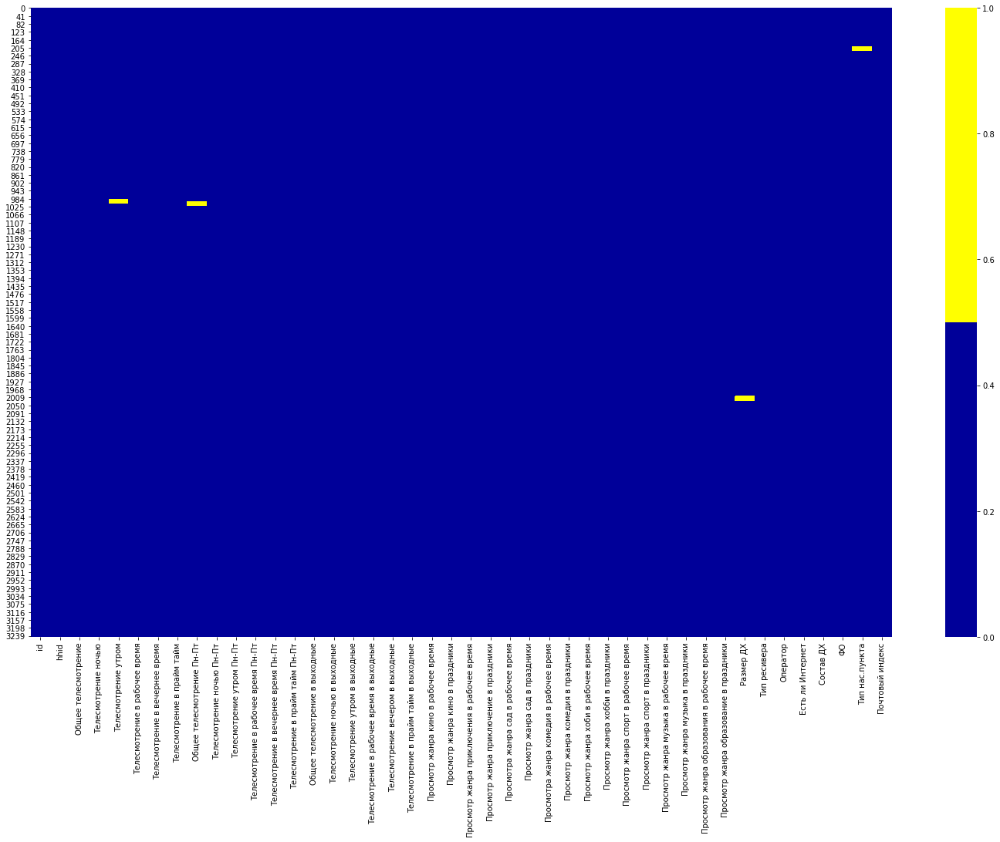

In [9]:
#построение тепловой карты пропусков
plt.figure(figsize=(25, 15))
colours = ['#000099', '#ffff00'] 
sns.heatmap(train_df.isnull(), cmap=sns.color_palette(colours))

In [10]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3244 entries, 0 to 3243
Data columns (total 44 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   id                                          3244 non-null   int64  
 1   hhid                                        3244 non-null   int64  
 2   Общее телесмотрение                         3244 non-null   int64  
 3   Телесмотрение ночью                         3244 non-null   int64  
 4   Телесмотрение утром                         3219 non-null   float64
 5   Телесмотрение в рабочее время               3244 non-null   int64  
 6   Телесмотрение в вечернее время              3244 non-null   int64  
 7   Телесмотрение в прайм тайм                  3244 non-null   int64  
 8   Общее телесмотрение Пн-Пт                   3219 non-null   float64
 9   Телесмотрение ночью Пн-Пт                   3244 non-null   int64  
 10  Телесмотрени

In [11]:
# Пропуски в столбцах: 
# 1. Телесмотрение утром 
# 2. Общее телесмотрение Пн-Пт
# 3. Размер ДХ
# 4. Тип нас.пункта

## Заполнение пропусков 

### Пропуски в "Общее телесмотрение Пн-Пт"

In [12]:
# Пропуски в "Общее телесмотрение Пн-Пт"

tv_watch_all = train_df[['Общее телесмотрение', 'Общее телесмотрение Пн-Пт', 'Общее телесмотрение в выходные']]
#Видна логика: 'Общее телесмотрение' = 'Общее телесмотрение Пн-Пт' + 'Общее телесмотрение в выходные'

In [13]:
tv_watch_all.head()

,Общее телесмотрение,Общее телесмотрение Пн-Пт,Общее телесмотрение в выходные
0,647,195.0,452
1,2657,415.0,2242
2,1385,729.0,656
3,2861,1249.0,1612
4,478,260.0,218


In [14]:
# x = tv_watch['Общее телесмотрение']
tv_watch_all = tv_watch_all.fillna({'Общее телесмотрение Пн-Пт': tv_watch_all['Общее телесмотрение']-tv_watch_all['Общее телесмотрение в выходные']})

In [15]:
#удаление старого столбца и добавление нового столбца к данным 
# train_df = train_df.drop(['Общее телесмотрение Пн-Пт'], axis=1)

In [16]:
train_df['Общее телесмотрение Пн-Пт'] = train_df['Общее телесмотрение Пн-Пт']\
    .fillna(train_df['Общее телесмотрение']-train_df['Общее телесмотрение в выходные'])

### Пропуски в "Телесмотрение утром"

In [17]:
# Пропуски в "Телесмотрение утром"

tv_watch_morning = train_df[['Телесмотрение утром', 'Телесмотрение утром Пн-Пт', 'Телесмотрение утром в выходные']]
tv_watch_morning.head()
#Видна логика: 'Телесмотрение утром' = 'Телесмотрение утром Пн-Пт' + 'Телесмотрение утром в выходные'

,Телесмотрение утром,Телесмотрение утром Пн-Пт,Телесмотрение утром в выходные
0,15.0,0,15
1,363.0,0,363
2,49.0,49,0
3,857.0,270,587
4,44.0,0,44


In [18]:
tv_watch_morning = tv_watch_morning.fillna({'Телесмотрение утром': tv_watch_morning['Телесмотрение утром Пн-Пт']+tv_watch_morning['Телесмотрение утром в выходные']})

In [19]:
train_df['Телесмотрение утром'] = train_df['Телесмотрение утром'].\
    fillna(train_df['Телесмотрение утром Пн-Пт']+train_df['Телесмотрение утром в выходные'])

### Пропуски в "Размер ДХ"

In [20]:
#Пропуски в "Размер ДХ"

#у каждого домохозяйства hhid есть свой размер ДХ 
HHid = train_df[['hhid', 'Размер ДХ']]
HHid.head()

,hhid,Размер ДХ
0,3348,4.0
1,4182,4.0
2,1233,2.0
3,4813,2.0
4,1782,4.0


In [21]:
#кол-во уникальных hhid 
HHid.hhid.nunique()

1362

In [22]:
#способ просмотра строк, где значения пропущены, чтобы потом посмотреть как они вставились:
lost_val = HHid.fillna(777).rename(columns={"Размер ДХ":"Размер_ДХ"}).query('Размер_ДХ == 777')
lost_val.head

<bound method NDFrame.head of       hhid  Размер_ДХ
2004  1561      777.0
2005   662      777.0
2006  4612      777.0
2007  5065      777.0
2008  4947      777.0
2009  5489      777.0
2010   797      777.0
2011  3066      777.0
2012  5476      777.0
2013  4301      777.0
2014  4857      777.0
2015   583      777.0
2016  4328      777.0
2017  4049      777.0
2018  5333      777.0
2019  4255      777.0
2020  4984      777.0
2021  5412      777.0
2022  4242      777.0
2023   512      777.0
2024  4716      777.0
2025  4352      777.0
2026  4699      777.0
2027  4016      777.0
2028  4285      777.0>

In [23]:
HHid.query('hhid == 512')

,hhid,Размер ДХ
2023,512,NaN


In [24]:
#Вспомогательная таблица id домохозяйств и его размера для соединения с общей бд и добавления пропусков
hhid_sizehh = HHid.groupby('hhid').agg({'Размер ДХ':'max'})

In [25]:
hhid_sizehh.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1362 entries, 6 to 5538
Data columns (total 1 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Размер ДХ  1361 non-null   float64
dtypes: float64(1)
memory usage: 21.3 KB


In [26]:
#видно, что всё равно есть один пропуск, это означает, что есть один hhid, который представлен в train данных с пропуском в единтсвенном экземпляре

In [27]:
#смотрим какой именно hhid 
hhid_sizehh.fillna(777).rename(columns={"Размер ДХ":"Размер_ДХ"}).query('Размер_ДХ == 777')

,Размер_ДХ
hhid,
512,777.0


In [28]:
#посмотрим есть ли размер дх с данным id в тестовых данных 
test_df[['hhid', 'Размер ДХ']].query('hhid == 512')
# ...ии это 1

,hhid,Размер ДХ
318,512,1


In [29]:
hhid_sizehh = hhid_sizehh.fillna(1) #простой способ заполнить пропуск известным значением 

In [30]:
#соединение вспомогательной таблицы и основной
train_df = train_df.merge(hhid_sizehh, how='left', on='hhid')

In [31]:
train_df = train_df.drop(['Размер ДХ_x'], axis=1).rename(columns={'Размер ДХ_y':'Размер ДХ'})

### Пропуски в "Тип нас. пункта"

In [32]:
#Пропуски в "Тип нас. пункта"
#Аналогично с домохозяйством - тип населенного пункта будет одинаков у данных с одним и тем же индексом 

In [33]:
train_df['Почтовый индекс'].nunique()

842

In [34]:
locality = train_df[['Тип нас.пункта', 'Почтовый индекс']]
locality.head(5)

,Тип нас.пункта,Почтовый индекс
0,Город с численностью от 45 тыс. до 400 тыс.,182180
1,Город с численностью менее 45 тыс.,457024
2,Город более 400 тыс.,350901
3,Сельский населенный пункт,452774
4,Сельский населенный пункт,168068


In [35]:
locality.rename(columns={"Почтовый индекс":'Почтовый_индекс'}).query("Почтовый_индекс == 167009")

,Тип нас.пункта,Почтовый_индекс
221,NaN,167009


In [36]:
#Вспомогательная таблица
locality_table = locality.groupby('Почтовый индекс').agg({'Тип нас.пункта': 'last'}) 

In [37]:
locality_table.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 842 entries, 0 to 6177000
Data columns (total 1 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Тип нас.пункта  841 non-null    object
dtypes: object(1)
memory usage: 13.2+ KB


In [38]:
#также получается, что один из индексов представлен только в одном числе и в нём пропущенное значение 

In [39]:
#Поиск индекса пропущенного населенного пункта
locality.groupby('Почтовый индекс').agg({'Тип нас.пункта': 'last'}).fillna(777).rename(columns={'Тип нас.пункта': 'Тип_нас_пункта'}).query('Тип_нас_пункта == 777')

,Тип_нас_пункта
Почтовый индекс,
167009,777


In [40]:
#возьмём значение населенного пункта из test данных 
test_df[['Почтовый индекс', 'Тип нас.пункта']].rename(columns={'Почтовый индекс':'Почтовый_индекс'}).query('Почтовый_индекс == 167009')

,Почтовый_индекс,Тип нас.пункта
467,167009,Город с численностью от 45 тыс. до 400 тыс.


In [41]:
#заполнение единственного пропуска
locality_table = locality_table.fillna('Город с численностью от 45 тыс. до 400 тыс.')

In [42]:
train_df = train_df.merge(locality_table, how='left', on='Почтовый индекс') 

In [43]:
#удаление старого столбца с пропусками, переименование нового столбца 
train_df = train_df.drop(['Тип нас.пункта_x'], axis=1).rename(columns={'Тип нас.пункта_y':'Тип нас.пункта'})

## Работа с выбросами

In [44]:
#Сначала анализ категориальных данных, заодно проверка на разные регистры или опечатки 
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3244 entries, 0 to 3243
Data columns (total 44 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   id                                          3244 non-null   int64  
 1   hhid                                        3244 non-null   int64  
 2   Общее телесмотрение                         3244 non-null   int64  
 3   Телесмотрение ночью                         3244 non-null   int64  
 4   Телесмотрение утром                         3244 non-null   float64
 5   Телесмотрение в рабочее время               3244 non-null   int64  
 6   Телесмотрение в вечернее время              3244 non-null   int64  
 7   Телесмотрение в прайм тайм                  3244 non-null   int64  
 8   Общее телесмотрение Пн-Пт                   3244 non-null   float64
 9   Телесмотрение ночью Пн-Пт                   3244 non-null   int64  
 10  Телесмотрени

In [45]:
train_df['Тип ресивера'].value_counts()

Ресивер с поддержкой HEVC    1849
Ресивер с поддержкой HDTV    1395
Name: Тип ресивера, dtype: int64

In [46]:
train_df.groupby('ФО').agg({'ФО':'count'}).rename(columns={'ФО': 'count'})

,count
ФО,
Приволжский федеральный округ,704
Северо-Западный федеральный округ,236
Северо-Кавказский федеральный округ,338
Сибирский федеральный округ,272
Уральский федеральный округ,236
Центральный федеральный округ,976
Южный федеральный округ,482


In [47]:
train_df['Тип нас.пункта'].value_counts()

Сельский населенный пункт                      1471
Город с численностью менее 45 тыс.              905
Город с численностью от 45 тыс. до 400 тыс.     537
Город более 400 тыс.                            331
Name: Тип нас.пункта, dtype: int64

In [48]:
train_df['hhid'].nunique()

1362

In [49]:
#C категориальными признаками всё нормально, посмотрим на численные

In [50]:
train_df.describe().iloc[:,1:10]

,hhid,Общее телесмотрение,Телесмотрение ночью,Телесмотрение утром,Телесмотрение в рабочее время,Телесмотрение в вечернее время,Телесмотрение в прайм тайм,Общее телесмотрение Пн-Пт,Телесмотрение ночью Пн-Пт
count,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000
mean,3715.987053,1321.359741,141.231504,194.180025,779.622688,126.118064,80.207460,552.698829,56.258631
std,1631.316478,1090.990367,225.381630,209.244039,649.145021,154.810000,155.594555,527.581092,103.379151
min,6.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2916.000000,474.000000,0.000000,0.000000,268.750000,0.000000,0.000000,68.000000,0.000000
50%,4289.500000,1066.000000,33.000000,136.000000,636.500000,73.000000,0.000000,449.000000,0.000000
75%,4956.250000,1935.000000,194.000000,317.000000,1165.000000,201.000000,97.000000,848.250000,70.000000
max,5538.000000,7799.000000,1580.000000,1076.000000,4588.000000,699.000000,951.000000,3400.000000,661.000000


In [51]:
train_df.describe().iloc[:,11:20]

,Телесмотрение в рабочее время Пн-Пт,Телесмотрение в вечернее время Пн-Пт,Телесмотрение в прайм тайм Пн-Пт,Общее телесмотрение в выходные,Телесмотрение ночью в выходные,Телесмотрение утром в выходные,Телесмотрение в рабочее время в выходные,Телесмотрение вечером в выходные,Телесмотрение в прайм тайм в выходные
count,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000
mean,327.086005,50.567509,32.589704,768.660912,84.972873,107.983046,452.536683,75.550555,47.617756
std,326.492802,73.610840,74.025699,683.943425,149.600638,138.348749,411.203928,99.804423,100.740166
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.000000,0.000000,0.000000,224.000000,0.000000,0.000000,110.000000,0.000000,0.000000
50%,250.000000,0.000000,0.000000,607.000000,2.000000,42.500000,365.000000,16.000000,0.000000
75%,549.000000,109.000000,8.250000,1147.250000,111.000000,182.000000,700.000000,121.000000,41.000000
max,1847.000000,365.000000,441.000000,4399.000000,919.000000,768.000000,2741.000000,477.000000,550.000000


In [52]:
train_df.describe().iloc[:,21:30]

,Просмотр жанра кино в праздники,Просмотр жанра приключения в рабочее время,Просмотр жанра приключение в праздники,Просмотра жанра сад в рабочее время,Просмотр жанра сад в праздники,Просмотра жанра комедия в рабочее время,Просмотр жанра комедия в праздники,Просмотр жанра хоби в рабочее время,Просмотр жанра хобби в праздники
count,3244.000000,3244.000000,3244.00000,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000
mean,22.808261,2.705302,7.07984,13.396116,14.804254,2.077682,1.911837,10.471332,24.706535
std,65.603108,12.683075,25.28530,43.138848,53.268757,11.451926,11.404577,32.687413,63.149443
min,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,5.000000,0.000000,0.00000,2.000000,1.000000,0.000000,0.000000,1.000000,13.000000
max,720.000000,236.000000,289.00000,576.000000,570.000000,174.000000,172.000000,353.000000,675.000000


In [53]:
train_df.describe().iloc[:,31:36]

,Просмотр жанра спорт в праздники,Просмотр жанра музыка в рабочее время,Просмотр жанра музыка в праздники,Просмотр жанра образования в рабочее время,Просмотр жанра образование в праздники
count,3244.000000,3244.000000,3244.000000,3244.000000,3244.000000
mean,4.685265,2.529285,2.387793,5.238286,9.227189
std,26.961420,17.641199,16.014969,22.894338,35.167541
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000
max,504.000000,259.000000,236.000000,419.000000,463.000000


In [54]:
#Используем классический способ избавления от выбросов, ориентируясь на квартили, выбросами будем считать те значения что разсположены выше верхней 
# границы боксплота Q3+1.5*IQR 
# но при простом применении на данные с временем просмотра данный способ работать не будет так как есть колонки с большим количеством 
# нулевых элементов, это значит, что мода и медиана будут равны нулю, квартили также будут равным нулю, 
# значит определяющая граница также будет нулевой, значит любые числовые значения будут считаться 
# выбросами и заменяться на неадекватную границу, 
# чтобы справиться с данным минусом будем убирать выбросы по раннее заданной метке, но только среди положительных значений признака 

In [55]:
for column in tqdm(list(train_df.columns[2:-8])):
    positive_val_list = []
    for value in train_df['%s' %column].values.tolist():
        if value>0:
            positive_val_list.append(value)

    Q1 = pd.DataFrame(positive_val_list).quantile(0.25)        
    Q3 = pd.DataFrame(positive_val_list).quantile(0.75)
    mean_of_pos_list = pd.DataFrame(positive_val_list).mean().iloc[0]
    IQR = Q3 - Q1
    threshold = Q3+1.5*IQR

    train_df['%s' %column] = train_df['%s' %column]\
        .apply(lambda x: mean_of_pos_list if x>0 and x>int(threshold.iloc[0]) else x )

  0%|          | 0/34 [00:00<?, ?it/s]

In [56]:
train_df.shape

(3244, 44)

## Добавление новых признаков, анализ определяемых

In [57]:
#Рассмотрим категориальные данные, которые надо Восстановить:

In [58]:
train_df.groupby('Оператор').agg({'Оператор':'count'}).rename(columns={'Оператор': 'count'})

,count
Оператор,
Подключен к Триколор ТВ и к другому оператору спутникового/кабельного ТВ,361
Подключен только к Триколор ТВ,2883


In [59]:
train_df.groupby('Есть ли Интернет').agg({'Есть ли Интернет':'count'}).rename(columns={'Есть ли Интернет': 'count'})

,count
Есть ли Интернет,
Есть,2100
Нет,1144


In [60]:
train_df.groupby('Состав ДХ').agg({'Состав ДХ':'count'}).rename(columns={'Состав ДХ': 'count'})

,count
Состав ДХ,
Есть члены семьи в возрасте 55+ лет и есть до 18 лет,313
Есть члены семьи в возрасте 55+ лет и нет до 18 лет,1149
Нет членов семьи в возрасте 55+ лет и есть до 18 лет,1147
Нет членов семьи в возрасте 55+ лет и нет до 18 лет,635


### 'Есть ли интернет'

In [61]:
#Рассмотрим взаимосвязь типа населенного пункта и наличия интернета 

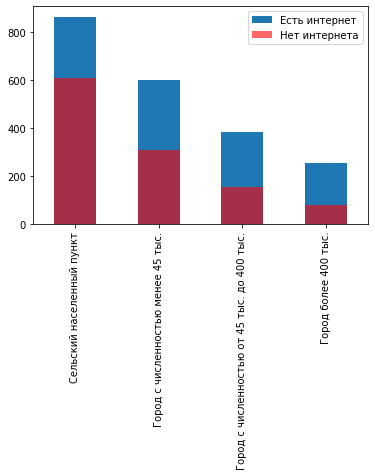

In [62]:
train_df.rename(columns={'Есть ли Интернет':'Есть_ли_Интернет'})\
    .query('Есть_ли_Интернет == "Есть"')['Тип нас.пункта'].value_counts().plot.bar(label='Есть интернет')

train_df.rename(columns={'Есть ли Интернет':'Есть_ли_Интернет'})\
    .query('Есть_ли_Интернет == "Нет"')['Тип нас.пункта'].value_counts().plot.bar(alpha=0.6, color='red', label='Нет интернета')
plt.legend()

In [63]:
# ==> Создать бинарный признак Деревня/ Не_Деревня, потому как хорошо видно, что в деревне у большего числа людей нет интернета чем в других местностях 
Country = train_df[['Тип нас.пункта']].rename(columns={'Тип нас.пункта':'Тип_нас_пункта'})

In [64]:
Country['Деревня_НеДеревня'] = Country['Тип_нас_пункта'].apply(lambda x: 1 if x == 'Сельский населенный пункт' else 0)

In [65]:
#Проверим влияет ли федеральный округ на признак наличия интернета, по логике да, чем дальше на восток, тем меньше должно быть его там

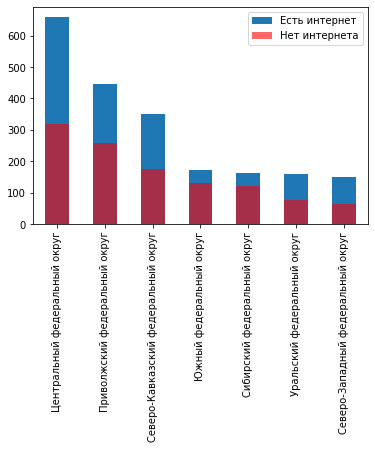

In [66]:
train_df.rename(columns={'Есть ли Интернет':'Есть_ли_Интернет'})\
    .query('Есть_ли_Интернет == "Есть"')['ФО'].value_counts().plot.bar(label='Есть интернет')

train_df.rename(columns={'Есть ли Интернет':'Есть_ли_Интернет'})\
    .query('Есть_ли_Интернет == "Нет"')['ФО'].value_counts().plot.bar(alpha=0.6, color='red', label='Нет интернета')
plt.legend()

In [67]:
# ==> проблемы с интернетом возникают в южном и сибирском федеральном округе, в данной выборке, пользователей без интернета преобладает 
# над теми, что с интернетом именно там 
#попробуем сделать бинарный признак "Это_ЮжныйСиб_ФО"

In [68]:
SouthPark = train_df[['ФО']]

In [69]:
SouthPark['Это_ЮжныйСиб_ФО'] = SouthPark['ФО'].apply(lambda x: 1 if x=='Южный федеральный округ' or x=='Сибирский федеральный округ' else 0)


In [70]:
#Посмотрим как зависит общее телесмотрение в выходные от того есть ли интернет, по логике оно должно быть больше, когда нет интернета, 
# то есть, чем больше смотрят телевизор в выходные, тем больше вероятность, что интернета нет

In [71]:
pd.DataFrame({'+':
    train_df.rename(columns={'Есть ли Интернет':'Есть_ли_Интернет'})\
    .query('Есть_ли_Интернет == "Есть"')['Общее телесмотрение в выходные'].describe(),
            '-':
    train_df.rename(columns={'Есть ли Интернет':'Есть_ли_Интернет'})\
    .query('Есть_ли_Интернет == "Нет"')['Общее телесмотрение в выходные'].describe() 
    })

 #.value_counts() #.plot.bar(label='Есть интернет')

,+,-
count,2100.000000,1144.000000
mean,666.779355,804.121581
std,582.016260,581.280014
min,0.000000,0.000000
25%,188.000000,346.000000
50%,543.000000,750.000000
75%,1017.250000,1168.750000
max,2512.000000,2504.000000


In [72]:
# ==> это так но, в среднем у кого нет интернета, по выходным смотрят tv больше, чем те у кого интернет есть, 
# но разница незначительна, нет смысла делать какой-либо бинарный признак

In [73]:
#Проверим взаимосвязь общего телесмотрение с наличием интернета 

<AxesSubplot:xlabel='Есть ли Интернет', ylabel='Общее телесмотрение'>

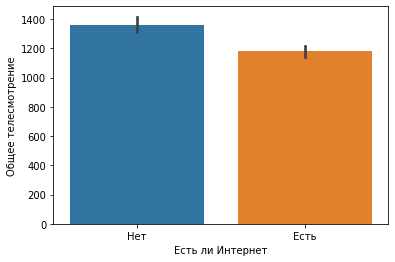

In [74]:
sns.barplot(x=train_df['Есть ли Интернет'],y=train_df['Общее телесмотрение'])

In [75]:
# ==>логично, что у тех у кого нет интернета общее телесмотрение выше, для создания бинарного признака на данной основе, 
# получим более точные цифры квартилей распределения обоих случаев 

pd.DataFrame({'Есть Интернет':
    train_df.rename(columns={'Есть ли Интернет':'Есть_ли_Интернет'})\
    .query('Есть_ли_Интернет == "Есть"')['Общее телесмотрение'].describe(),

            'Нет Интернета':
    train_df.rename(columns={'Есть ли Интернет':'Есть_ли_Интернет'})\
    .query('Есть_ли_Интернет == "Нет"')['Общее телесмотрение'].describe() 
    })


,Есть Интернет,Нет Интернета
count,2100.000000,1144.000000
mean,1180.509767,1361.598733
std,943.222893,935.091174
min,1.000000,1.000000
25%,416.000000,568.000000
50%,954.500000,1254.000000
75%,1726.500000,2025.000000
max,4115.000000,4100.000000


In [76]:
# ==> у 50% пользователей пользующихся интернетом время общего телесмотрения не выходит за 927 секунд, создадим бинарный признак 

In [77]:
Watch_Time = train_df[['Общее телесмотрение', 'Есть ли Интернет']]

In [78]:
Watch_Time ['Лимит_просмотраТВ'] = Watch_Time ['Общее телесмотрение'].apply(lambda x: 1 if x>1000 else 0)

In [79]:
Watch_Time 

,Общее телесмотрение,Есть ли Интернет,Лимит_просмотраТВ
0,647.0,Нет,0
1,2657.0,Есть,1
2,1385.0,Есть,1
3,2861.0,Нет,1
4,478.0,Есть,0
...,...,...,...
3239,697.0,Есть,0
3240,532.0,Есть,0
3241,1153.0,Нет,1
3242,871.0,Есть,0


### 'Оператор' 

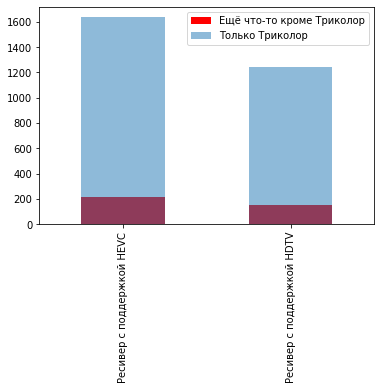

In [80]:
#Проверим гипотезу о взаимосвязи типа ресивера и оператора
train_df.query('Оператор == "Подключен к Триколор ТВ и к другому оператору спутникового/кабельного ТВ"')['Тип ресивера'].value_counts().plot\
    .bar(color='red', label='Ещё что-то кроме Триколор')

train_df.query('Оператор == "Подключен только к Триколор ТВ"')['Тип ресивера'].value_counts().plot\
    .bar(alpha=0.5, label='Только Триколор')
plt.legend()

In [81]:
# ==> ресиверами с HDTV пользуется меньшее число пользователей чем HEVC, тем не менее с большей вероятностью окажется, 
# что владелец ресивера с HDTV окажется пользователем оператора не только триколор, чем владелец ресивера HEVC, посмотрим...

In [82]:
#проанализируем связь между федеральным округом и оператором, возможно триколор не добрался в достаточной мере до определенных округов 
# и где-то его присутствие ощутимо меньше

In [83]:
train_df.query('Оператор == "Подключен к Триколор ТВ и к другому оператору спутникового/кабельного ТВ"')['ФО'].value_counts() #.plot.bar(label='Есть интернет') #.describe(),
          

    # train_df.rename(columns={'Есть ли Интернет':'Есть_ли_Интернет'})\
    # .query('Есть_ли_Интернет == "Нет"')['Общее телесмотрение в выходные'].describe() 
    # })

Центральный федеральный округ          105
Приволжский федеральный округ           97
Южный федеральный округ                 69
Сибирский федеральный округ             33
Северо-Западный федеральный округ       22
Уральский федеральный округ             21
Северо-Кавказский федеральный округ     14
Name: ФО, dtype: int64

In [84]:
train_df.query('Оператор == "Подключен только к Триколор ТВ"')['ФО'].value_counts()

Центральный федеральный округ          871
Приволжский федеральный округ          607
Южный федеральный округ                413
Северо-Кавказский федеральный округ    324
Сибирский федеральный округ            239
Уральский федеральный округ            215
Северо-Западный федеральный округ      214
Name: ФО, dtype: int64

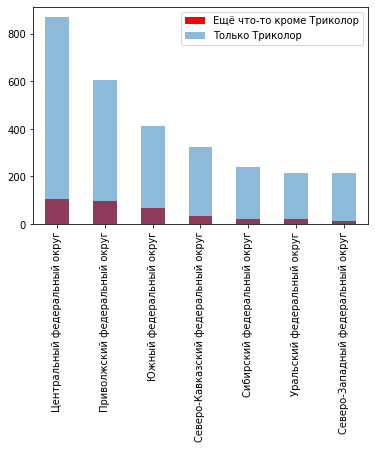

In [85]:
train_df.query('Оператор == "Подключен к Триколор ТВ и к другому оператору спутникового/кабельного ТВ"')['ФО'].value_counts().plot\
    .bar(color='red', label='Ещё что-то кроме Триколор')

train_df.query('Оператор == "Подключен только к Триколор ТВ"')['ФО'].value_counts().plot\
    .bar(alpha=0.5, label='Только Триколор')
plt.legend()

In [86]:
#Не просматривается какой-то тенденции, нет смысла выделять какие-то округа, возможно из-за недостаточного кол-ва данных, но скорее всего, 
# люди подключают еще что-то потому что хотят другие какие-то услуги кроме тех, что предоставляет организация Триколор и таких, логично, меньше

In [87]:
#Проверка теории, что возможно оператор не добрался до определенных типов населенных пунктов 

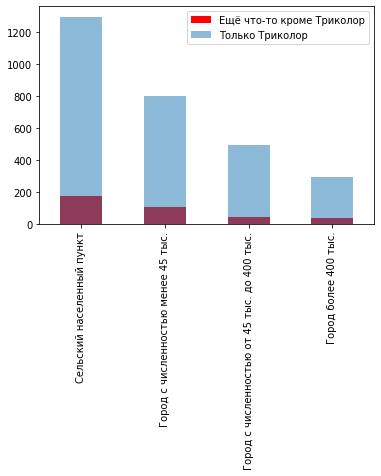

In [88]:
train_df.query('Оператор == "Подключен к Триколор ТВ и к другому оператору спутникового/кабельного ТВ"')['Тип нас.пункта'].value_counts().plot\
    .bar(color='red', label='Ещё что-то кроме Триколор')

train_df.query('Оператор == "Подключен только к Триколор ТВ"')['Тип нас.пункта'].value_counts().plot\
    .bar(alpha=0.5, label='Только Триколор')
plt.legend()

In [89]:
#==> больше всего используют что-то кроме триколора в сельских местностях, но и больше всего его тоже там используют, то есть одноверменно и
# подтвердили справдливость бинарного признака "Деревня_НеДеревня" и показали, что из-за изначального имбаланса признака "Оператор" достаточно сложно 
# строить теории 

In [90]:
# Почтовый индекс и оператор

In [91]:
tab4 = train_df[['Почтовый индекс', 'Оператор']] 

In [92]:
#не уловить взаимосвязь, возможно нужно смотреть то по какой логике присуждаются индексы, какая цифра, что значит и это скорее поможет в определении 
# "Есть ли интернет", так как будет территриальной характеристикой 

### 'Состав ДХ'

In [93]:
#Проверим признак состава дх. 
# Размер ДХ точно должен быть взаимосвязан с его составом

In [94]:
train_df[['Состав ДХ', 'Размер ДХ']].groupby('Состав ДХ').agg({'Размер ДХ':'mean'})

,Размер ДХ
Состав ДХ,
Есть члены семьи в возрасте 55+ лет и есть до 18 лет,4.543131
Есть члены семьи в возрасте 55+ лет и нет до 18 лет,2.107050
Нет членов семьи в возрасте 55+ лет и есть до 18 лет,3.914560
Нет членов семьи в возрасте 55+ лет и нет до 18 лет,2.211024


In [95]:
# ==>видна связь, можно создать признак разделяющий ДХ по принципу, ДХ где нет детей, и где они есть

In [96]:
Children = train_df[['Состав ДХ', 'Размер ДХ']]

In [97]:
Children['НаличиеНесовершеннолетнихвДХ'] =  train_df['Размер ДХ'].apply(lambda x: 1 if x>2 else 0)

In [98]:
# Оценим взаимосвязь признака общее телесмотрение с составом дх, скорее всего чем больше состав дх, тем больше
#  будет времени телесмотрения 

In [99]:
train_df[['Состав ДХ', 'Общее телесмотрение']].groupby('Состав ДХ').agg({'Общее телесмотрение':'mean'}) #.plot.bar()

,Общее телесмотрение
Состав ДХ,
Есть члены семьи в возрасте 55+ лет и есть до 18 лет,1228.537247
Есть члены семьи в возрасте 55+ лет и нет до 18 лет,1295.826450
Нет членов семьи в возрасте 55+ лет и есть до 18 лет,1193.275326
Нет членов семьи в возрасте 55+ лет и нет до 18 лет,1251.363645


In [100]:
# ==> среднее общее телесмотрение у каждой группы в составе дх примерно одинаковое 

In [101]:
#Проверим теорию о том, что среднее телесмотение в рабочее время в ПН-ПТ будет выделять некоторые составы ДХ особенно хорошо,
# потому что люди 55+, которые сидят дома и до 18 лет, маленькие дети и школьники особенно будут смотреть ТВ именно в рабочее время

In [102]:
tab1 = train_df[['Состав ДХ', 'Телесмотрение в рабочее время Пн-Пт']]

In [103]:
tab1.groupby('Состав ДХ').agg({'Телесмотрение в рабочее время Пн-Пт':'mean'})

,Телесмотрение в рабочее время Пн-Пт
Состав ДХ,
Есть члены семьи в возрасте 55+ лет и есть до 18 лет,314.635854
Есть члены семьи в возрасте 55+ лет и нет до 18 лет,347.090649
Нет членов семьи в возрасте 55+ лет и есть до 18 лет,296.036637
Нет членов семьи в возрасте 55+ лет и нет до 18 лет,337.538583


In [104]:
# ==>телесмотрение в раб время в будние дни показало что люди 55+ не имеющие рядом людей до 18 лет 
# больше всех остальных групп смотрят ТВ в раб время, то есть это пенсионеры без внуков 

#на втором месте дх где нет людей 55+ и нет до 18, то есть это, могут быть безработные люди и/или домохозяйки

#попробуем отделить эти две группы и помочь алгоритму с определением состава ДХ

In [105]:
tab1['ПросмотрТВпоБудням'] = tab1['Телесмотрение в рабочее время Пн-Пт'].apply(lambda x: 1 if x>320 else 0)

In [106]:
tab1

,Состав ДХ,Телесмотрение в рабочее время Пн-Пт,ПросмотрТВпоБудням
0,Нет членов семьи в возрасте 55+ лет и есть до ...,12.0,0
1,Нет членов семьи в возрасте 55+ лет и есть до ...,282.0,0
2,Есть члены семьи в возрасте 55+ лет и нет до 1...,571.0,1
3,Есть члены семьи в возрасте 55+ лет и нет до 1...,662.0,1
4,Нет членов семьи в возрасте 55+ лет и есть до ...,53.0,0
...,...,...,...
3239,Нет членов семьи в возрасте 55+ лет и есть до ...,126.0,0
3240,Нет членов семьи в возрасте 55+ лет и есть до ...,6.0,0
3241,Есть члены семьи в возрасте 55+ лет и нет до 1...,279.0,0
3242,Есть члены семьи в возрасте 55+ лет и есть до ...,45.0,0


In [107]:
# Проверим какая есть зависимость состава ДХ от типа населенного пункта 

<AxesSubplot:xlabel='Тип нас.пункта', ylabel='count'>

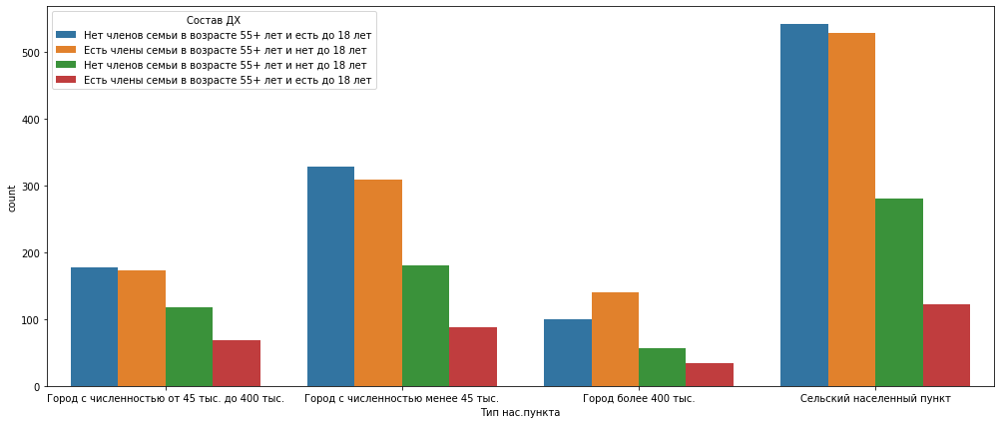

In [108]:
plt.figure(figsize=(17, 7))

sns.countplot(x=train_df['Тип нас.пункта'], hue=train_df['Состав ДХ'])

In [109]:
# ==> заметно, что селький населенный пункт выделяется наличием Родителей до 55+ с детьми, и 
# только пенсионерами или близкими к пенсионному возрасту людьми 55+ 

# Подтвердилась теория о выделении сельского населенного пункта в отдельный признак

In [110]:
train_df.shape

(3244, 44)

In [111]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3244 entries, 0 to 3243
Data columns (total 44 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   id                                          3244 non-null   int64  
 1   hhid                                        3244 non-null   int64  
 2   Общее телесмотрение                         3244 non-null   float64
 3   Телесмотрение ночью                         3244 non-null   float64
 4   Телесмотрение утром                         3244 non-null   float64
 5   Телесмотрение в рабочее время               3244 non-null   float64
 6   Телесмотрение в вечернее время              3244 non-null   float64
 7   Телесмотрение в прайм тайм                  3244 non-null   float64
 8   Общее телесмотрение Пн-Пт                   3244 non-null   float64
 9   Телесмотрение ночью Пн-Пт                   3244 non-null   float64
 10  Телесмотрени

### Итого
 по данному пункту 5 новых признаков

In [112]:
train_df['Деревня_НеДеревня'] = train_df['Тип нас.пункта'].apply(lambda x: 1 if x == 'Сельский населенный пункт' else 0)
train_df['Это_ЮжныйСиб_ФО'] = train_df['ФО'].apply(lambda x: 1 if x=='Южный федеральный округ' or x=='Сибирский федеральный округ' else 0)
train_df['Лимит_просмотраТВ'] = train_df['Общее телесмотрение'].apply(lambda x: 1 if x>1000 else 0)
train_df['ПросмотрТВпоБудням'] = train_df['Телесмотрение в рабочее время Пн-Пт'].apply(lambda x: 1 if x>320 else 0)
train_df['НаличиеНесовершеннолетнихвДХ'] =  train_df['Размер ДХ'].apply(lambda x: 1 if x>2 else 0)

In [113]:
train_df.shape

(3244, 49)

## Детекция неинформативных признаков и дубликатов

In [114]:
#Поиск колонок, где одно и то же значение занимает более 95% пространства колонки, то есть будет неинформативно для модели 
num_rows = len(train_df.index)
low_information_cols = [] 

for col in train_df.columns:
    cnts = train_df[col].value_counts()
    top_pct = (cnts/num_rows).iloc[0]
    
    if top_pct > 0.90:
        low_information_cols.append(col)
        print('{0}: {1:.5f}%'.format(col, top_pct*100))
        # print(cnts) #какие именно значения сколько раз встречаются
        print('______________________________________')

Просмотр жанра комедия в праздники: 90.10481%
______________________________________
Просмотр жанра музыка в рабочее время: 94.29716%
______________________________________
Просмотр жанра музыка в праздники: 93.58816%
______________________________________


In [115]:
#95% никто не достиг, но есть выше 90% с одинаковыми нулевыми значениями, скорее всего столбцы не информативны, без разницы удлаять или нет

In [116]:
#Дубликаты 
#после удаления из данных id пользователей, находим больше 1000 повторов, но id пользователя в данной классификации используется как фича, так что удаление данной фичи и дубликатов только уменьшит качество модели 

## Создание числовых лейблов для определяемых переменных

In [117]:
#Трансформируем определяемые категориальные данные в количественные

In [118]:
train_df['Состав ДХ2'] = pd.DataFrame({'Состав ДХ2':preprocessing.LabelEncoder().fit_transform(train_df['Состав ДХ'])})
# Есть члены семьи в возрасте 55+ лет и нет до 18 лет    1
# Нет членов семьи в возрасте 55+ лет и есть до 18 лет   2
# Нет членов семьи в возрасте 55+ лет и нет до 18 лет    3
# Есть члены семьи в возрасте 55+ лет и есть до 18 лет   0

train_df['Оператор'] = train_df['Оператор'].apply(lambda x: 1 if x=='Подключен только к Триколор ТВ' else 0)
# train_df['Оператор2'] = pd.DataFrame({'Оператор2':preprocessing.LabelEncoder().fit_transform(train_df['Оператор'])})
# Подключен только к Триколор ТВ                                              1
# Подключен к Триколор ТВ и к другому оператору спутникового/кабельного ТВ    0
train_df['Есть ли Интернет'] = train_df['Есть ли Интернет'].apply(lambda x: 1 if x=='Есть' else 0)
# train_df['Есть ли Интернет2'] = pd.DataFrame({'Есть ли Интернет2':preprocessing.LabelEncoder().fit_transform(train_df['Есть ли Интернет'])})
# Есть    1
# Нет     0

train_df = train_df.drop(['Состав ДХ'], axis=1).rename(columns={'Состав ДХ2':'Состав ДХ'})


# Обучение + Метрики 

In [119]:
train_df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3244 entries, 0 to 3243
Data columns (total 49 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   id                                          3244 non-null   int64  
 1   hhid                                        3244 non-null   int64  
 2   Общее телесмотрение                         3244 non-null   float64
 3   Телесмотрение ночью                         3244 non-null   float64
 4   Телесмотрение утром                         3244 non-null   float64
 5   Телесмотрение в рабочее время               3244 non-null   float64
 6   Телесмотрение в вечернее время              3244 non-null   float64
 7   Телесмотрение в прайм тайм                  3244 non-null   float64
 8   Общее телесмотрение Пн-Пт                   3244 non-null   float64
 9   Телесмотрение ночью Пн-Пт                   3244 non-null   float64
 10  Телесмотрени

In [120]:
#Подбираем для каждого случая классификации свои признаки

y1 = train_df['Есть ли Интернет']
y2 = train_df['Оператор']
y3 = train_df['Состав ДХ']

#для простоты редактуры состава X признаков выведем их отдельно 
  
X = train_df[['Общее телесмотрение', 'Телесмотрение ночью',      #   'id', 'hhid', 'Почтовый индекс'
       'Телесмотрение утром', 'Телесмотрение в рабочее время', 
       'Телесмотрение в вечернее время', 'Телесмотрение в прайм тайм',
       'Общее телесмотрение Пн-Пт', 'Телесмотрение ночью Пн-Пт',
       'Телесмотрение утром Пн-Пт', 'Телесмотрение в рабочее время Пн-Пт',
       'Телесмотрение в вечернее время Пн-Пт', 
       'Телесмотрение в прайм тайм Пн-Пт', 'Общее телесмотрение в выходные',
       'Телесмотрение ночью в выходные', 'Телесмотрение утром в выходные',
       'Телесмотрение в рабочее время в выходные',
       'Телесмотрение вечером в выходные',
       'Телесмотрение в прайм тайм в выходные',
       'Просмотр жанра кино в рабочее время',
       'Просмотр жанра кино в праздники',
       'Просмотр жанра приключения в рабочее время',
       'Просмотр жанра приключение в праздники',
       'Просмотра жанра сад в рабочее время', 'Просмотр жанра сад в праздники',
       'Просмотра жанра комедия в рабочее время',
       'Просмотр жанра комедия в праздники',
       'Просмотр жанра хоби в рабочее время',
       'Просмотр жанра хобби в праздники',
       'Просмотр жанра спорт в рабочее время',
       'Просмотр жанра спорт в праздники',
       'Просмотр жанра музыка в рабочее время',
       'Просмотр жанра музыка в праздники',
       'Просмотр жанра образования в рабочее время',
       'Просмотр жанра образование в праздники', 
       'Размер ДХ', 'Тип ресивера', 'ФО', 'Тип нас.пункта', 'Деревня_НеДеревня',
       'Это_ЮжныйСиб_ФО', 'Лимит_просмотраТВ', 'ПросмотрТВпоБудням', 
       'НаличиеНесовершеннолетнихвДХ']]

cat_features = ['Тип ресивера', 'ФО', 'Тип нас.пункта'] #нужны бещ smote 

In [121]:
#классы не сбалансированы, значит дальнейшая стретегия действий связана либо с существенным редактирование вероятности реузльтата, 
# либо с применением алгоритма SMOTE, который искусственно создаёт баланс, путём 
# создания элементов в непосредственной близости от уже существующих в меньшем наборе
# ==> используем второй способ, т.к. в smote можно задвать только числовые значения придётся отказаться от категориальных признаков в catboost и 
# транформировать такие фичи в разряженные вектора из 0 и 1 заранее. 
y1.value_counts(normalize=True), y2.value_counts(normalize=True), y3.value_counts(normalize=True) 

(1    0.647349
 0    0.352651
 Name: Есть ли Интернет, dtype: float64,
 1    0.888718
 0    0.111282
 Name: Оператор, dtype: float64,
 1    0.354192
 2    0.353576
 3    0.195746
 0    0.096486
 Name: Состав ДХ, dtype: float64)

In [123]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3244 entries, 0 to 3243
Data columns (total 43 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   Общее телесмотрение                         3244 non-null   float64
 1   Телесмотрение ночью                         3244 non-null   float64
 2   Телесмотрение утром                         3244 non-null   float64
 3   Телесмотрение в рабочее время               3244 non-null   float64
 4   Телесмотрение в вечернее время              3244 non-null   float64
 5   Телесмотрение в прайм тайм                  3244 non-null   float64
 6   Общее телесмотрение Пн-Пт                   3244 non-null   float64
 7   Телесмотрение ночью Пн-Пт                   3244 non-null   float64
 8   Телесмотрение утром Пн-Пт                   3244 non-null   float64
 9   Телесмотрение в рабочее время Пн-Пт         3244 non-null   float64
 10  Телесмотрени

In [124]:
#функция, которая находит лучшие комбинации гиперпараметров, и считает нужные метрики для каждого из трёх случаев

def cat_report(X, y1, y2, y3):
   X =  pd.get_dummies(X)
   y_list = [y1, y2, y3]
   for y in tqdm(y_list):
      
      
      X_final, y_final = SMOTE(random_state=42).fit_resample(X, y) #баланс 
      X_train, X_test, y_train, y_test = train_test_split(X_final, y_final, train_size = 0.85, random_state=42)
      model = CatBoostClassifier(verbose=False,
         #модель сама выбирает функцию для потимизации, поэтому здесь явно указывать не нужно 
                                 iterations = 1500,
                                 random_state=42,
                                 early_stopping_rounds=250, 
                                 eval_metric='Kappa') #метрика на которую ориентируется модель при обучении 
                                 # cat_features=cat_features) - если действовать без алгоритма балансировки классов 
                                 

      parameters = {                                             #в идеале поставить кол-во деревьев ~10тыс со скоростью обучения 0.03 или около того, 
                     'l2_leaf_reg': [2, 3, 4],                                  # но тогда обучаться будет дольше, но модель будет качественнее 
                     'learning_rate': [0.1, 0.2, 0.3, 0.4]
                     }

      

      Fitted_model = GridSearchCV(estimator=model, param_grid = parameters, cv=3, n_jobs=-1).fit(X_train, y_train, eval_set=(X_test, y_test))

      if y is y1:
         a =  "Есть ли Интернет"
         print('Отчёт по признаку %s' %a)
         
      elif y is y2:
         a =  "Оператор"
         print('Отчёт по признаку %s' %a)

      elif y is y3:
         a = 'Состав ДХ'
         print('Отчёт по признаку %s' %a)

      if y is y1 or y is y2:
         
         y_score = Fitted_model.predict_proba(X_test)[:,1]
         fpr, tpr, thr = roc_curve(y_test, y_score) #рок кривая
         roc = pd.DataFrame({'fpr':fpr,'tpr':tpr,'thr':thr})  #таблица со значениеями trp, fpr, и границы
         title1 = 'ROC Curve для характеристики "%s"' %a
         roc.plot(x='fpr',y='tpr',figsize=(6,6),grid=True, title=title1)

         probab = pd.DataFrame({'probability':y_score}) #вероятность отнесения к классу
         title2 = 'Результат работы модели по разделению классов для характеристики "%s"' %a
         probab.plot(kind='hist', title=title2, grid=True, legend=False);

         roc['tpr-fpr'] = roc['tpr'] - roc['fpr'] 
         #можно контролировать уровень уверенности в случае если какая-то ошибка стоит дороже чем другая
         best_thr = roc.sort_values('tpr-fpr',ascending=False)['thr'].iloc[0] #лучшая граница разделяющая классы 
         y_pred = (y_score >= best_thr)*1  
         print('Лучшая граница вероятности:', best_thr)

      if y is y3:

         y_pred = Fitted_model.predict(X_test)
         probab = pd.DataFrame(y_pred) #вероятность отнесения к классу
         title1 = 'Результат работы модели по разделению классов для характеристики "%s"' %a
         probab.plot(kind='hist', title=title1, grid=True, legend=False);


      #Результат
      print(
      'Cohhens Kappa:', cohen_kappa_score(y_pred, y_test),'\n'
      'Accuracy:', accuracy_score(y_pred, y_test),'\n'
      'F1-score:', f1_score(y_pred, y_test, average='weighted'),'\n'
      'Лучшая модель:', Fitted_model.best_estimator_.get_params(), '\n'
      '____________________________________________\n',
      '____________________________________________'
      )

  0%|          | 0/3 [00:00<?, ?it/s]

Отчёт по признаку Есть ли Интернет
Лучшая граница вероятности: 0.42047669662490716
Cohhens Kappa: 0.8253968253968254 
Accuracy: 0.9126984126984127 
F1-score: 0.9126612238519299 
Лучшая модель: {'iterations': 1500, 'learning_rate': 0.2, 'l2_leaf_reg': 3, 'verbose': False, 'eval_metric': 'Kappa', 'random_state': 42, 'early_stopping_rounds': 250} 
____________________________________________
 ____________________________________________
Отчёт по признаку Оператор
Лучшая граница вероятности: 0.5038592790202876
Cohhens Kappa: 0.9583856741948417 
Accuracy: 0.9791907514450867 
F1-score: 0.9791921420658135 
Лучшая модель: {'iterations': 1500, 'learning_rate': 0.1, 'l2_leaf_reg': 4, 'verbose': False, 'eval_metric': 'Kappa', 'random_state': 42, 'early_stopping_rounds': 250} 
____________________________________________
 ____________________________________________
Отчёт по признаку Состав ДХ
Cohhens Kappa: 0.8762408147479696 
Accuracy: 0.9072463768115943 
F1-score: 0.9072391439840171 
Лучшая мод

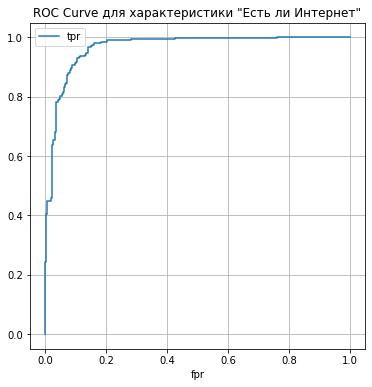

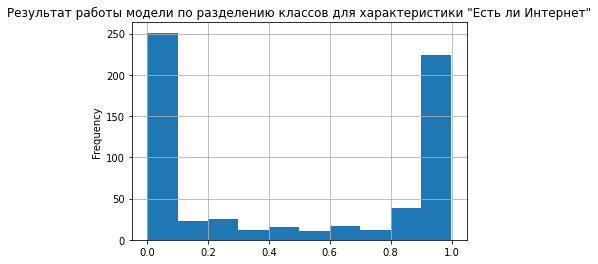

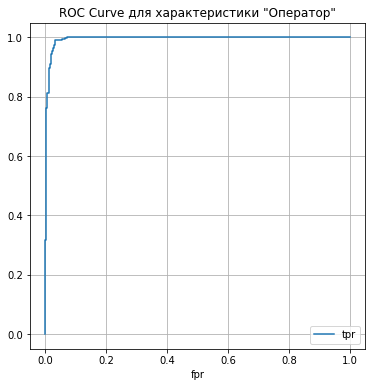

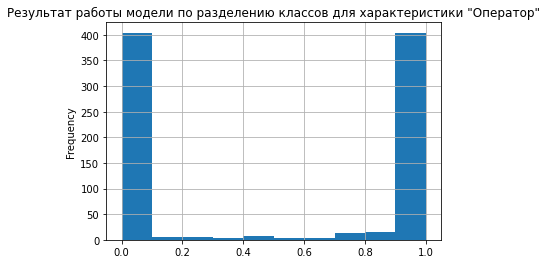

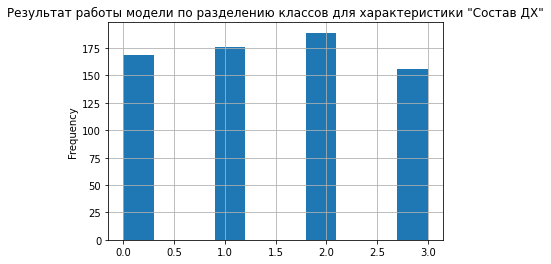

In [125]:
#построение отчёта может занять от 13 минут
cat_report(X, y1, y2, y3) 

# Создание сабмита

In [124]:
test_df

,id,hhid,Общее телесмотрение,Телесмотрение ночью,Телесмотрение утром,Телесмотрение в рабочее время,Телесмотрение в вечернее время,Телесмотрение в прайм тайм,Общее телесмотрение Пн-Пт,Телесмотрение ночью Пн-Пт,...,Просмотр жанра спорт в праздники,Просмотр жанра музыка в рабочее время,Просмотр жанра музыка в праздники,Просмотр жанра образования в рабочее время,Просмотр жанра образование в праздники,Размер ДХ,Тип ресивера,ФО,Тип нас.пункта,Почтовый индекс
0,3244,5299,2613,266,265,1973,109,0,1004,52,...,111,0,0,2,9,1,Ресивер с поддержкой HDTV,Центральный федеральный округ,Город с численностью менее 45 тыс.,152470
1,3245,4357,1914,1011,512,391,0,0,602,443,...,0,21,0,36,9,4,Ресивер с поддержкой HEVC,Приволжский федеральный округ,Сельский населенный пункт,452151
2,3246,347,1044,0,0,973,41,30,694,0,...,8,0,0,0,0,2,Ресивер с поддержкой HDTV,Центральный федеральный округ,Город более 400 тыс.,153045
3,3247,4050,661,0,0,524,120,17,650,0,...,0,0,0,0,0,7,Ресивер с поддержкой HEVC,Центральный федеральный округ,Сельский населенный пункт,143081
4,3248,5199,2788,1295,712,770,0,11,1010,581,...,0,0,0,29,198,1,Ресивер с поддержкой HEVC,Сибирский федеральный округ,Город с численностью менее 45 тыс.,662340
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
806,4050,565,3440,431,300,1750,463,496,1604,118,...,0,0,0,0,1,3,Ресивер с поддержкой HDTV,Центральный федеральный округ,Город более 400 тыс.,153008
807,4051,4747,914,7,20,865,22,0,400,0,...,0,0,0,0,0,2,Ресивер с поддержкой HEVC,Центральный федеральный округ,Сельский населенный пункт,309740
808,4052,4400,1331,1,0,526,474,330,754,1,...,0,0,0,0,0,4,Ресивер с поддержкой HDTV,Южный федеральный округ,Город более 400 тыс.,350088
809,4053,3089,2748,788,440,1260,189,71,491,164,...,9,0,0,4,178,2,Ресивер с поддержкой HEVC,Сибирский федеральный округ,Город более 400 тыс.,656012


In [125]:
#визуальный анализ типов и пропусков
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 811 entries, 0 to 810
Data columns (total 41 columns):
 #   Column                                      Non-Null Count  Dtype 
---  ------                                      --------------  ----- 
 0   id                                          811 non-null    int64 
 1   hhid                                        811 non-null    int64 
 2   Общее телесмотрение                         811 non-null    int64 
 3   Телесмотрение ночью                         811 non-null    int64 
 4   Телесмотрение утром                         811 non-null    int64 
 5   Телесмотрение в рабочее время               811 non-null    int64 
 6   Телесмотрение в вечернее время              811 non-null    int64 
 7   Телесмотрение в прайм тайм                  811 non-null    int64 
 8   Общее телесмотрение Пн-Пт                   811 non-null    int64 
 9   Телесмотрение ночью Пн-Пт                   811 non-null    int64 
 10  Телесмотрение утром Пн-Пт 

In [126]:
#Редактирование тестового датасета

#Проработка выбросов 
for column in list(test_df.columns[2:-5]):
    positive_val_list = []
    for value in test_df['%s' %column].values.tolist():
        if value>0:
            positive_val_list.append(value)

    Q1 = pd.DataFrame(positive_val_list).quantile(0.25)        
    Q3 = pd.DataFrame(positive_val_list).quantile(0.75)
    mean_of_pos_list = pd.DataFrame(positive_val_list).mean().iloc[0]
    IQR = Q3 - Q1
    threshold = Q3+1.5*IQR

    test_df['%s' %column] = test_df['%s' %column]\
        .apply(lambda x: mean_of_pos_list if x>0 and x>int(threshold.iloc[0]) else x )

#Добавление новых фичей 
test_df['Деревня_НеДеревня'] = test_df['Тип нас.пункта'].apply(lambda x: 1 if x == 'Сельский населенный пункт' else 0)
test_df['Это_ЮжныйСиб_ФО'] = test_df['ФО'].apply(lambda x: 1 if x=='Южный федеральный округ' or x=='Сибирский федеральный округ' else 0)
test_df['Лимит_просмотраТВ'] = test_df['Общее телесмотрение'].apply(lambda x: 1 if x>1000 else 0)
test_df['ПросмотрТВпоБудням'] = test_df['Телесмотрение в рабочее время Пн-Пт'].apply(lambda x: 1 if x>320 else 0)
test_df['НаличиеНесовершеннолетнихвДХ'] =  test_df['Размер ДХ'].apply(lambda x: 1 if x>2 else 0)

In [127]:
X.shape, test_df.shape

((3244, 46), (811, 46))

In [128]:
#Обучим выбранный алгоритм на всём датасете и сделаем сабмит
predictions=[]
def make_submit(X, y1, y2, y3, test_df):

   X =  pd.get_dummies(X)
   test_df = pd.get_dummies(test_df)
   y_list = [y1, y2, y3]
   for y in tqdm(y_list):
      
      X_final, y_final = SMOTE(random_state=42).fit_resample(X, y) #баланс 
      model = CatBoostClassifier(verbose=False,
                                 iterations = 1500,
                                 random_state=42,
                                 early_stopping_rounds=250, 
                                 eval_metric='Kappa')
      parameters = {                                              
                     'l2_leaf_reg': [2, 3, 4],                                  
                     'learning_rate': [0.1, 0.2, 0.3, 0.4]
                     }

      Fitted_model = GridSearchCV(estimator=model, param_grid = parameters, cv=3, n_jobs=-1).fit(X_final, y_final)
# 
      # Fitted_model = model.fit(X_final, y_final)
      
      if y is y1:
         a =  "Есть ли Интернет"
         
      elif y is y2:
         a =  "Оператор"

      elif y is y3:
         a = 'Состав ДХ'

      if y is y1 or y is y2:
         y_score = Fitted_model.predict_proba(test_df)[:,1]
         probab = pd.DataFrame({'probability':y_score}) 
         title2 = 'Результат работы модели по разделению классов для характеристики "%s"' %a
         probab.plot(kind='hist', title=title2, grid=True, legend=False);
         y_pred = (y_score >= 0.5)*1  #по опыту модели выше можно редактировать границу вероятности принадлжености к классу
         predictions.append(y_pred)

      if y is y3:
         y_pred = Fitted_model.predict(test_df)
         probab = pd.DataFrame(y_pred) 
         title1 = 'Результат работы модели по разделению классов для характеристики "%s"' %a
         probab.plot(kind='hist', title=title1, grid=True, legend=False);
         predictions.append(y_pred)



  0%|          | 0/3 [00:00<?, ?it/s]

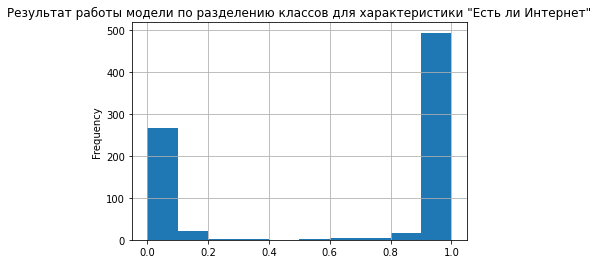

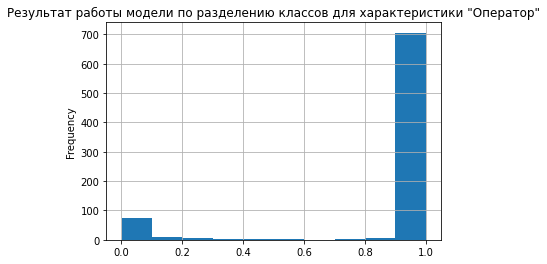

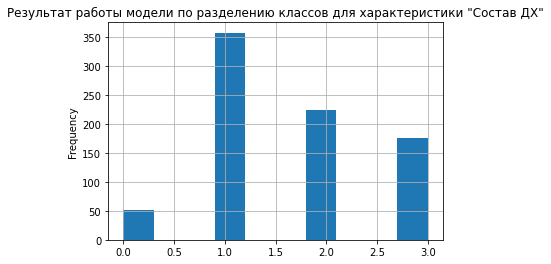

In [129]:
#Создание сабмита может занять до 20 минут 
make_submit(X, y1, y2, y3, test_df) 

#Создание единой таблицы 
HH_table = pd.DataFrame({'Состав ДХ': [1, 2, 3, 0], 
                         'Count': ['Есть члены семьи в возрасте 55+ лет и нет до 18 лет',
                                    'Нет членов семьи в возрасте 55+ лет и есть до 18 лет',
                                    'Нет членов семьи в возрасте 55+ лет и нет до 18 лет',
                                    'Есть члены семьи в возрасте 55+ лет и есть до 18 лет']})


Predict = pd.DataFrame({'id': test_df['id'], 'Оператор': predictions[1], 'Есть ли Интернет': predictions[0], 'Состав ДХ': predictions[2].ravel()}).\
    merge(HH_table, how='left', on='Состав ДХ').\
    set_index('id').drop(['Состав ДХ'], axis=1).\
    rename(columns={'Count': 'Состав ДХ'})

Predict['Есть ли Интернет'] = Predict['Есть ли Интернет']\
    .apply(lambda x: 'Есть' if x==1 else 'Нет')

Predict['Оператор'] = Predict['Оператор']\
    .apply(lambda x: 'Подключен только к Триколор ТВ' if x==1 else 'Подключен к Триколор ТВ и к другому оператору спутникового/кабельного ТВ')

In [130]:
Predict

,Оператор,Есть ли Интернет,Состав ДХ
id,,,
3244,Подключен только к Триколор ТВ,Есть,Нет членов семьи в возрасте 55+ лет и нет до 1...
3245,Подключен только к Триколор ТВ,Есть,Есть члены семьи в возрасте 55+ лет и нет до 1...
3246,Подключен только к Триколор ТВ,Нет,Есть члены семьи в возрасте 55+ лет и нет до 1...
3247,Подключен только к Триколор ТВ,Есть,Нет членов семьи в возрасте 55+ лет и есть до ...
3248,Подключен только к Триколор ТВ,Нет,Есть члены семьи в возрасте 55+ лет и нет до 1...
...,...,...,...
4050,Подключен только к Триколор ТВ,Нет,Нет членов семьи в возрасте 55+ лет и есть до ...
4051,Подключен только к Триколор ТВ,Есть,Есть члены семьи в возрасте 55+ лет и нет до 1...
4052,Подключен только к Триколор ТВ,Есть,Нет членов семьи в возрасте 55+ лет и есть до ...


In [131]:
#памятка по лейблам
# Есть члены семьи в возрасте 55+ лет и нет до 18 лет    1
# Нет членов семьи в возрасте 55+ лет и есть до 18 лет   2
# Нет членов семьи в возрасте 55+ лет и нет до 18 лет    3
# Есть члены семьи в возрасте 55+ лет и есть до 18 лет   0

# Подключен только к Триколор ТВ                                              1
# Подключен к Триколор ТВ и к другому оператору спутникового/кабельного ТВ    0

# Есть    1
# Нет     0

In [132]:
#Сохранить csv файл
Predict.to_csv('Abramchuk05082021.csv')